In [1]:
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import os

# My SIFT LIB, it works not well in jupyter notebook
import my_sift

cv2.__version__

'3.3.0'

In [2]:
# Read directory function
def read_directory(directory_name):
    array_of_img = [] # Store all the image data
    filenumber = len([name for name in os.listdir(directory_name) if str(os.path.join(directory_name, name)).lower().endswith(("jpg", "png", "gif"))])
    for i in range(1, filenumber + 1):
        img = cv2.imread(directory_name + "/" + str(i)+".jpg")
        array_of_img.append(img)
    return array_of_img
                         
def SIFT(inputname):
    array_of_img = read_directory(inputname)
    #use: len(array_of_img) for looping the image, array_of_img[0],
    #array_of_img[1],array_of_img[2],...for processing each image
    #Start SIFT here


    #End of SIFT here and use imageoutput for your output
    imageoutput = array_of_img[0]
    array_of_img.clear()
    return imageoutput

In [3]:
# Create my sift instance
sift_featrue = my_sift.SiftFeature()

index_params = dict(algorithm=0, trees=5)
search_params = dict(checks=50)
flann_matcher = cv2.FlannBasedMatcher(index_params, search_params)

In [4]:
def find_sift_descriptor(input_image):
    gray_image = cv2.cvtColor(input_image, cv2.COLOR_BGR2GRAY)
    
    (key_points, descriptor) = my_sift.detectAndCompute(sift_featrue, gray_image)
    
#     img = cv2.drawKeypoints(input_image, key_points, np.array([]), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
#     fig, ax = plt.subplots(1, 1, figsize=(8, 8))
#     ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
#     ax.axis('off')
#     plt.show()
    
    return {'kpts':key_points, 'des':descriptor, 'gray_img':gray_image}

In [5]:
# sift_descriptor = cv2.xfeatures2d.SIFT_create()

def find_sift_descriptor_old(input_image):
    gray_image = cv2.cvtColor(input_image, cv2.COLOR_BGR2GRAY)
 
    (key_points, descriptor) = sift_descriptor.detectAndCompute(input_image, None)
    
#     img = cv2.drawKeypoints(input_image, key_points, np.array([]), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
#     fig, ax = plt.subplots(1, 1, figsize=(8, 8))
#     ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
#     ax.axis('off')
#     plt.show()
    
    return {'kpts':key_points, 'des':descriptor, 'gray_img':gray_image}
    

In [6]:
def cylindricalWarp(img, f):
    """This function returns the cylindrical warp for a given image and intrinsics matrix K"""
    h_,w_ = img.shape[:2]
    K = np.array([[f, 0, w_/2],[0, f, h_/2],[0,0,1]]) # mock intrinsics
    # pixel coordinates
    y_i, x_i = np.indices((h_,w_))
    X = np.stack([x_i,y_i,np.ones_like(x_i)],axis=-1).reshape(h_*w_,3) # to homog
    Kinv = np.linalg.inv(K) 
    X = Kinv.dot(X.T).T # normalized coords
    # calculate cylindrical coords (sin\theta, h, cos\theta)
    A = np.stack([np.sin(X[:,0]),X[:,1],np.cos(X[:,0])],axis=-1).reshape(w_*h_,3)
    B = K.dot(A.T).T # project back to image-pixels plane
    # back from homog coords
    B = B[:,:-1] / B[:,[-1]]
    # make sure warp coords only within image bounds
    B[(B[:,0] < 0) | (B[:,0] >= w_) | (B[:,1] < 0) | (B[:,1] >= h_)] = -1
    B = B.reshape(h_,w_,-1)
    
#     img_rgba = cv2.cvtColor(img,cv2.COLOR_BGR2BGR) # for transparent borders...
    # warp the image according to cylindrical coords
    result = cv2.remap(img, B[:,:,0].astype(np.float32), B[:,:,1].astype(np.float32), cv2.INTER_AREA, borderMode=cv2.BORDER_CONSTANT, borderValue=0)
    trim = 8
    return result[trim:result.shape[0]-trim,trim:result.shape[1]-trim,:]

In [7]:
def match(right_image_info, left_image_info):
    raw_matches = flann_matcher.knnMatch(right_image_info['des'], left_image_info['des'], k=2)
    
    # print('raw_matches len:', len(raw_matches))
    good_matches_list = []
    for (m, n) in raw_matches:
        # ensure the distance is within a certain ratio of each other (i.e. Lowe's ratio test)
        if m.distance < n.distance * 0.7:
            good_matches_list.append((m.trainIdx, m.queryIdx))

    if len(good_matches_list) > 4:
        pointsCurrent = right_image_info['kpts']
        pointsPrevious = left_image_info['kpts']

        matchedPointsCurrent = np.float32([pointsCurrent[i].pt for (_, i) in good_matches_list])
        matchedPointsPrev = np.float32([pointsPrevious[i].pt for (i, _) in good_matches_list])
        
        H, status = cv2.findHomography(matchedPointsCurrent, matchedPointsPrev, cv2.RANSAC, 4)
        return (good_matches_list, H, status)
    else:
        return None

In [8]:
def draw_matches(right_image_info, left_image_info, matches):
    # initialize the output visualization image
    hA, wA, = right_image_info['gray_img'].shape
    hB, wB, = left_image_info['gray_img'].shape
    export_image = np.zeros((max(hA, hB), wA + wB, 3), dtype="uint8")
    # export_image[0:hA, 0:wA] = right_image_info['raw_img']
    # export_image[0:hB, wA:] = left_image_info['raw_img']
    export_image[0:hB, 0:wB] = left_image_info['raw_img']
    export_image[0:hA, wB:] = right_image_info['raw_img']

    # loop over the matches
    for ((trainIdx, queryIdx), s) in zip(matches, status):
        # only process the match if the keypoint was successfully matched
        if s == 1:
            # draw the match
            # ptA = (int(right_image_info['kpts'][queryIdx].pt[0]), int(right_image_info['kpts'][queryIdx].pt[1]))
            # ptB = (int(left_image_info['kpts'][trainIdx].pt[0]) + wA, int(left_image_info['kpts'][trainIdx].pt[1]))
            ptA = (int(right_image_info['kpts'][queryIdx].pt[0]) + wB, int(right_image_info['kpts'][queryIdx].pt[1]))
            ptB = (int(left_image_info['kpts'][trainIdx].pt[0]), int(left_image_info['kpts'][trainIdx].pt[1]))
            cv2.line(export_image, ptA, ptB, (0, 255, 0), 1)

    # return the visualization
    return export_image

In [9]:
def removeBlackBorder(img):
    '''
    Remove img's the black border 
    '''
    h, w = img.shape[:2]
    reduced_h, reduced_w = h, w
    # right to left
    for col in range(w - 1, -1, -1):
        all_black = True
        for i in range(h):
            if (np.count_nonzero(img[i, col]) > 0):
                all_black = False
                break
        if (all_black == True):
            reduced_w = reduced_w - 1

    # bottom to top 
    for row in range(h - 1, -1, -1):
        all_black = True
        for i in range(reduced_w):
            if (np.count_nonzero(img[row, i]) > 0):
                all_black = False
                break
        if (all_black == True):
            reduced_h = reduced_h - 1

    return img[:reduced_h, :reduced_w]

In [10]:
def warp(img_left, img_right, HomoMat, blending_mode, padding_height=0):
    '''
       Warp image to create panoramic image
       There are three different blending method - noBlending、linearBlending、linearBlendingWithConstant
    '''
    (hl, wl) = img_left.shape[:2]
    (hr, wr) = img_right.shape[:2]
    stitch_img = np.zeros( (max(hl, hr) + padding_height, wl + wr, 3), dtype="int") # create the (stitch)big image accroding the imgs height and width 

    if (blending_mode == "noBlending"):
        stitch_img[:hl, :wl] = img_left

    # Transform Right image(the coordination of right image) to destination iamge(the coordination of left image) with HomoMat
    inv_H = np.linalg.inv(HomoMat)
    for i in range(stitch_img.shape[0]):
        for j in range(stitch_img.shape[1]):
            coor = np.array([j, i, 1])
            img_right_coor = inv_H @ coor # the coordination of right image
            img_right_coor /= img_right_coor[2]

            # you can try like nearest neighbors or interpolation  
            y, x = int(round(img_right_coor[0])), int(round(img_right_coor[1])) # y for width, x for height


            # if the computed coordination not in the (hegiht, width) of right image, it's not need to be process 
            if (x < 0 or x >= hr or y < 0 or y >= wr):
                continue
            # else we need the tranform for this pixel
            stitch_img[i, j] = img_right[x, y]


    # create the Blender object to blending the image
    blender = Blender()
    if (blending_mode == "linearBlending"):
        stitch_img = blender.linearBlending([img_left, stitch_img])
    elif (blending_mode == "linearBlendingWithConstant"):
        stitch_img = blender.linearBlendingWithConstantWidth([img_left, stitch_img])

    # remove the black border
#     stitch_img = removeBlackBorder(stitch_img)

    return stitch_img

In [11]:
class Blender:
    def linearBlending(self, imgs):
        '''
        linear Blending(also known as Feathering)
        '''
        img_left, img_right = imgs
        (hl, wl) = img_left.shape[:2]
        (hr, wr) = img_right.shape[:2]
        img_left_mask = np.zeros((hr, wr), dtype="int")
        img_right_mask = np.zeros((hr, wr), dtype="int")
        
        # find the left image and right image mask region(Those not zero pixels)
        for i in range(hl):
            for j in range(wl):
                if np.count_nonzero(img_left[i, j]) > 0:
                    img_left_mask[i, j] = 1
        for i in range(hr):
            for j in range(wr):
                if np.count_nonzero(img_right[i, j]) > 0:
                    img_right_mask[i, j] = 1
        
        # find the overlap mask(overlap region of two image)
        overlap_mask = np.zeros((hr, wr), dtype="int")
        for i in range(hr):
            for j in range(wr):
                if (np.count_nonzero(img_left_mask[i, j]) > 0 and np.count_nonzero(img_right_mask[i, j]) > 0):
                    overlap_mask[i, j] = 1
        
        # Plot the overlap mask
        ## plt.figure(21)
        ## plt.title("overlap_mask")
        ## plt.imshow(overlap_mask.astype(int), cmap="gray")
        
        # compute the alpha mask to linear blending the overlap region
        alpha_mask = np.zeros((hr, wr)) # alpha value depend on left image
        for i in range(hr): 
            minIdx = maxIdx = -1
            for j in range(wr):
                if (overlap_mask[i, j] == 1 and minIdx == -1):
                    minIdx = j
                if (overlap_mask[i, j] == 1):
                    maxIdx = j
            
            if (minIdx == maxIdx): # represent this row's pixels are all zero, or only one pixel not zero
                continue
                
            decrease_step = 1 / (maxIdx - minIdx)
            for j in range(minIdx, maxIdx + 1):
                alpha_mask[i, j] = 1 - (decrease_step * (j - minIdx))
        
        
        
        linearBlending_img = np.copy(img_right)
        linearBlending_img[:hl, :wl] = np.copy(img_left)
        # linear blending
        for i in range(hr):
            for j in range(wr):
                if (np.count_nonzero(overlap_mask[i, j]) > 0):
                    linearBlending_img[i, j] = alpha_mask[i, j] * img_left[i, j] + (1 - alpha_mask[i, j]) * img_right[i, j]
        
        return linearBlending_img
    def linearBlendingWithConstantWidth(self, imgs):
        '''
        linear Blending with Constat Width, avoiding ghost region
        # you need to determine the size of constant with
        '''
        img_left, img_right = imgs
        (hl, wl) = img_left.shape[:2]
        (hr, wr) = img_right.shape[:2]
        img_left_mask = np.zeros((hr, wr), dtype="int")
        img_right_mask = np.zeros((hr, wr), dtype="int")
        constant_width = 2 # constant width
        
        # find the left image and right image mask region(Those not zero pixels)
        for i in range(hl):
            for j in range(wl):
                if np.count_nonzero(img_left[i, j]) > 0:
                    img_left_mask[i, j] = 1
        for i in range(hr):
            for j in range(wr):
                if np.count_nonzero(img_right[i, j]) > 0:
                    img_right_mask[i, j] = 1
                    
        # find the overlap mask(overlap region of two image)
        overlap_mask = np.zeros((hr, wr), dtype="int")
        for i in range(hr):
            for j in range(wr):
                if (np.count_nonzero(img_left_mask[i, j]) > 0 and np.count_nonzero(img_right_mask[i, j]) > 0):
                    overlap_mask[i, j] = 1
        
        # compute the alpha mask to linear blending the overlap region
        alpha_mask = np.zeros((hr, wr)) # alpha value depend on left image
        for i in range(hr):
            minIdx = maxIdx = -1
            for j in range(wr):
                if (overlap_mask[i, j] == 1 and minIdx == -1):
                    minIdx = j
                if (overlap_mask[i, j] == 1):
                    maxIdx = j
            
            if (minIdx == maxIdx): # represent this row's pixels are all zero, or only one pixel not zero
                continue
                
            decrease_step = 1 / (maxIdx - minIdx)
            
            # Find the middle line of overlapping regions, and only do linear blending to those regions very close to the middle line.
            middleIdx = int((maxIdx + minIdx) / 2)
            
            # left 
            for j in range(minIdx, middleIdx + 1):
                if (j >= middleIdx - constant_width):
                    alpha_mask[i, j] = 1 - (decrease_step * (j - minIdx))
                else:
                    alpha_mask[i, j] = 1
            # right
            for j in range(middleIdx + 1, maxIdx + 1):
                if (j <= middleIdx + constant_width):
                    alpha_mask[i, j] = 1 - (decrease_step * (j - minIdx))
                else:
                    alpha_mask[i, j] = 0

        
        linearBlendingWithConstantWidth_img = np.copy(img_right)
        linearBlendingWithConstantWidth_img[:hl, :wl] = np.copy(img_left)
        # linear blending with constant width
        for i in range(hr):
            for j in range(wr):
                if (np.count_nonzero(overlap_mask[i, j]) > 0):
                    linearBlendingWithConstantWidth_img[i, j] = alpha_mask[i, j] * img_left[i, j] + (1 - alpha_mask[i, j]) * img_right[i, j]
        
        return linearBlendingWithConstantWidth_img

In [12]:
def get_image_bound(image):
    h_image = image.shape[0]
    w_image = image.shape[1]

    upper_bound = -1
    bottom_bound = -1
    left_bound = -1
    right_bound = -1

    for i in range(h_image):
        if np.count_nonzero(image[i, :]) > 0:
            upper_bound = i
            break

    for i in range(h_image - 1, 0, -1):
        if np.count_nonzero(image[i, :]) > 0:
            bottom_bound = i
            break

    for i in range(w_image):
        if np.count_nonzero(image[:, i]) > 0:
            left_bound = i
            break

    for i in range(w_image - 1, 0, -1):
        if np.count_nonzero(image[:, i]) > 0:
            right_bound = i
            break
    print(upper_bound, bottom_bound, left_bound, right_bound)
    return (upper_bound, bottom_bound, left_bound, right_bound)

In [13]:
def end2end_align(img, shifts):
    sum_y, sum_x = shifts# np.sum(shifts, axis=0)

    y_shift = np.abs(sum_y)
    col_shift = None

    # same sign
    if sum_x*sum_y > 0:
        col_shift = np.linspace(y_shift, 0, num=img.shape[1], dtype=np.uint16)
    else:
        col_shift = np.linspace(0, y_shift, num=img.shape[1], dtype=np.uint16)

    aligned = img.copy()
    for x in range(img.shape[1]):
        aligned[:,x] = np.roll(img[:,x], col_shift[x], axis=0)

    return aligned

In [14]:
def crop(img):
    _, thresh = cv2.threshold(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY), 1, 255, cv2.THRESH_BINARY)
    upper, lower = [-1, -1]

    black_pixel_num_threshold = img.shape[1]//100

    for y in range(thresh.shape[0]):
        if len(np.where(thresh[y] == 0)[0]) < black_pixel_num_threshold:
            upper = y
            break
        
    for y in range(thresh.shape[0]-1, 0, -1):
        if len(np.where(thresh[y] == 0)[0]) < black_pixel_num_threshold:
            lower = y
            break

    return img[upper:lower, :]


target directory: parrington
Process 1/17 images in directory:parrington
h: [[  1.           0.         241.83479736]
 [  0.           1.           5.        ]
 [  0.           0.           1.        ]]
0 500 0 609


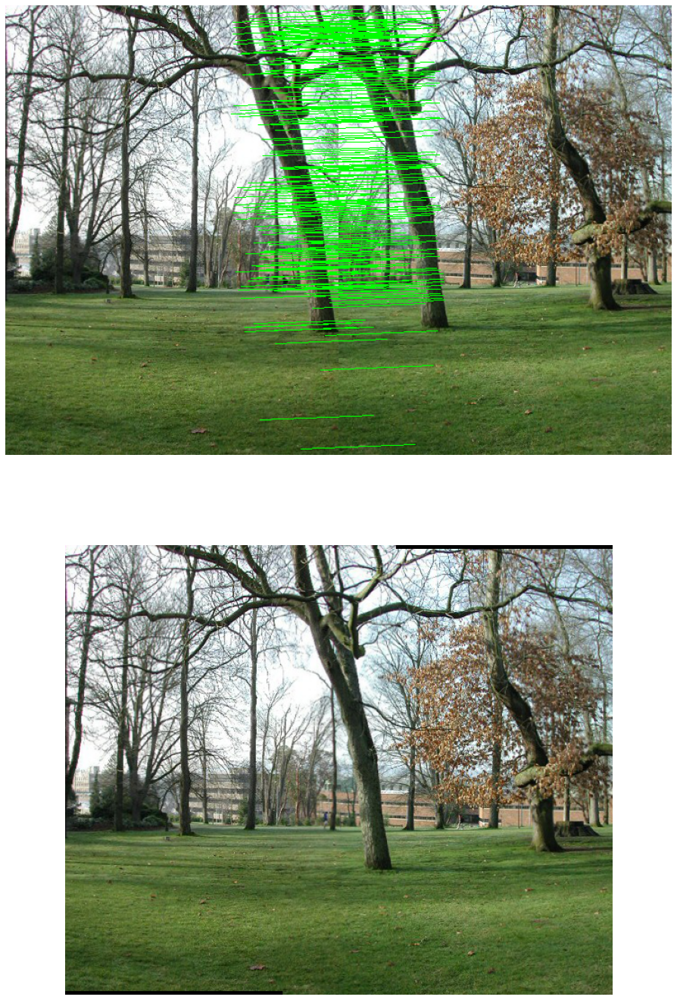

Process 2/17 images in directory:parrington
h: [[  1.           0.         486.35050999]
 [  0.           1.          10.        ]
 [  0.           0.           1.        ]]
0 505 0 853


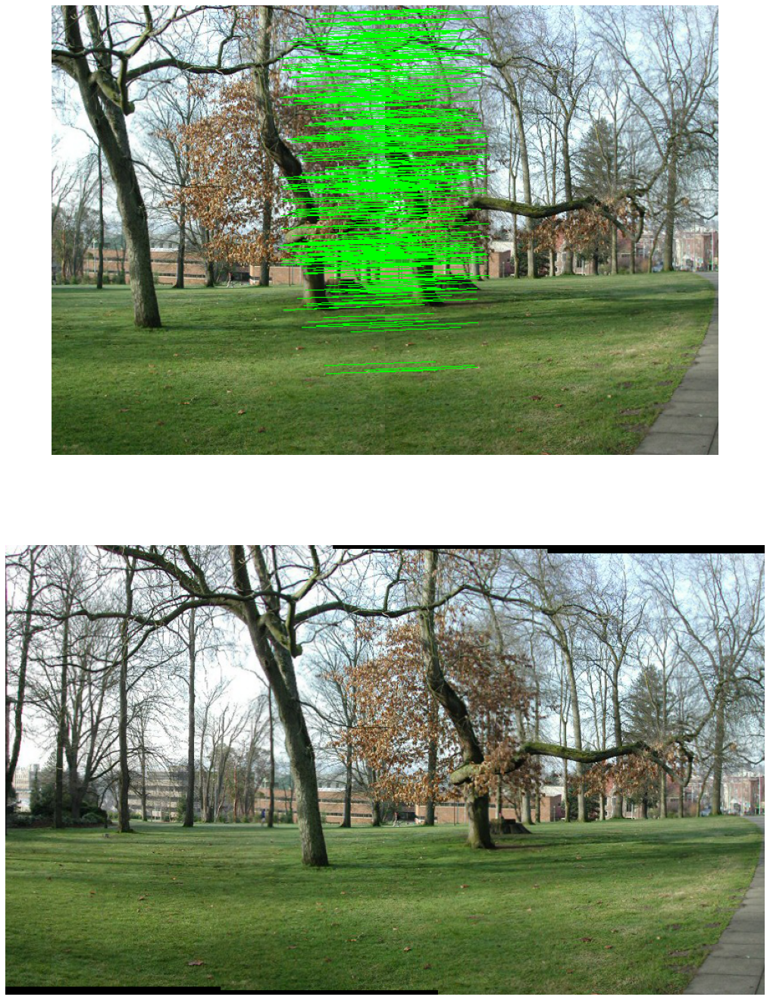

Process 3/17 images in directory:parrington
h: [[  1.           0.         735.96292354]
 [  0.           1.          15.        ]
 [  0.           0.           1.        ]]
0 510 0 1103


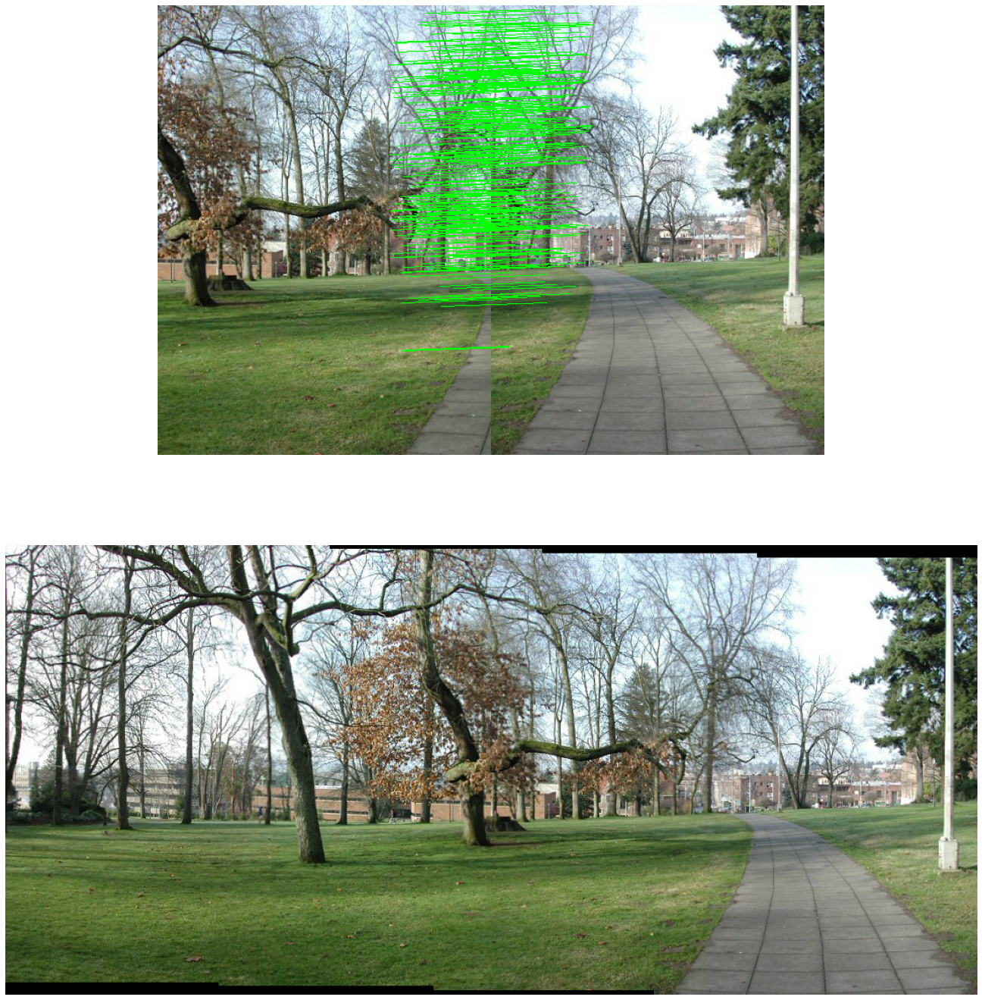

Process 4/17 images in directory:parrington
h: [[  1.           0.         976.10623943]
 [  0.           1.          20.        ]
 [  0.           0.           1.        ]]
0 515 0 1343


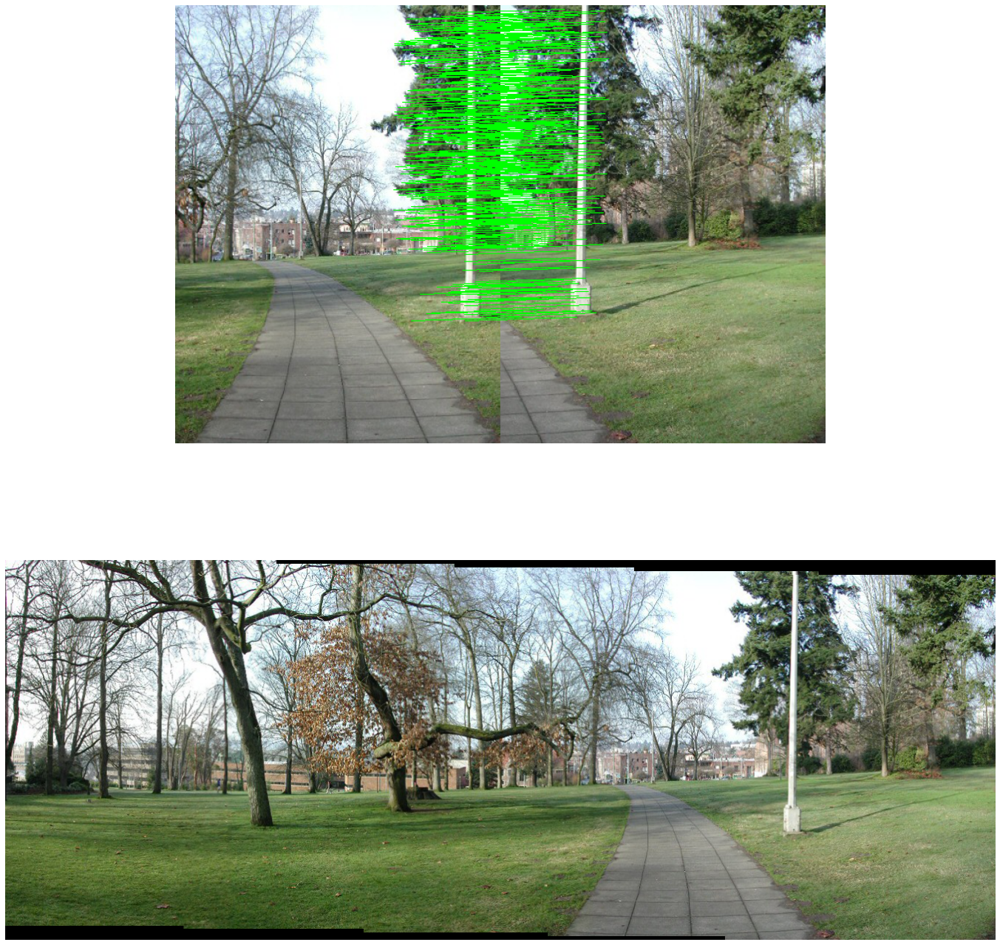

Process 5/17 images in directory:parrington
h: [[1.00000000e+00 0.00000000e+00 1.22196521e+03]
 [0.00000000e+00 1.00000000e+00 2.50000000e+01]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
0 520 0 1589


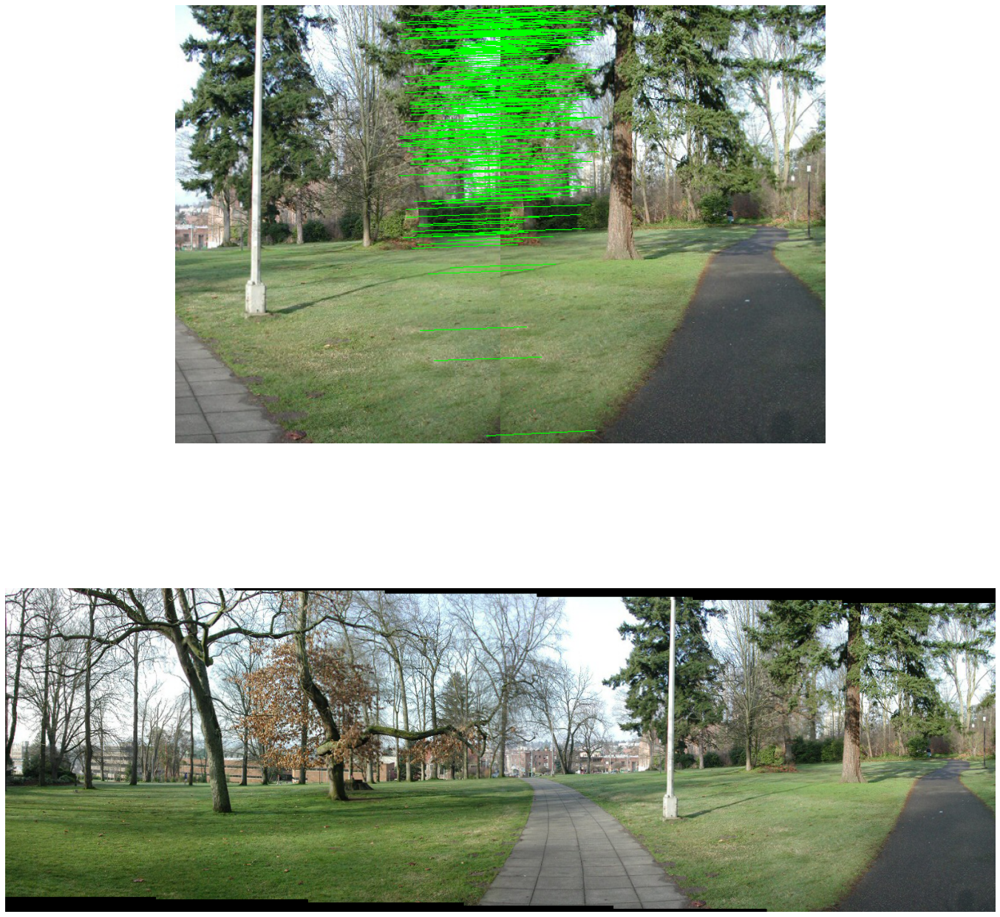

Process 6/17 images in directory:parrington
h: [[1.00000000e+00 0.00000000e+00 1.47067099e+03]
 [0.00000000e+00 1.00000000e+00 3.00000000e+01]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
0 525 0 1838


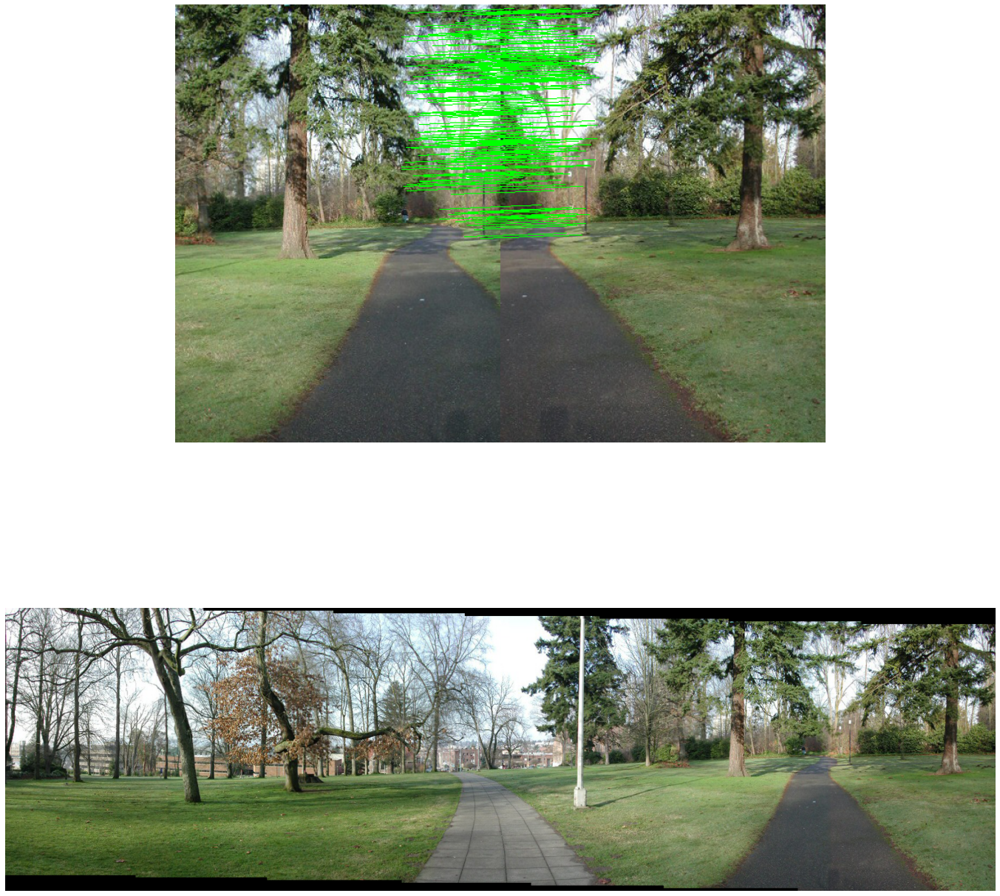

Process 7/17 images in directory:parrington
h: [[1.00000000e+00 0.00000000e+00 1.71025665e+03]
 [0.00000000e+00 1.00000000e+00 3.50000000e+01]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
0 530 0 2077


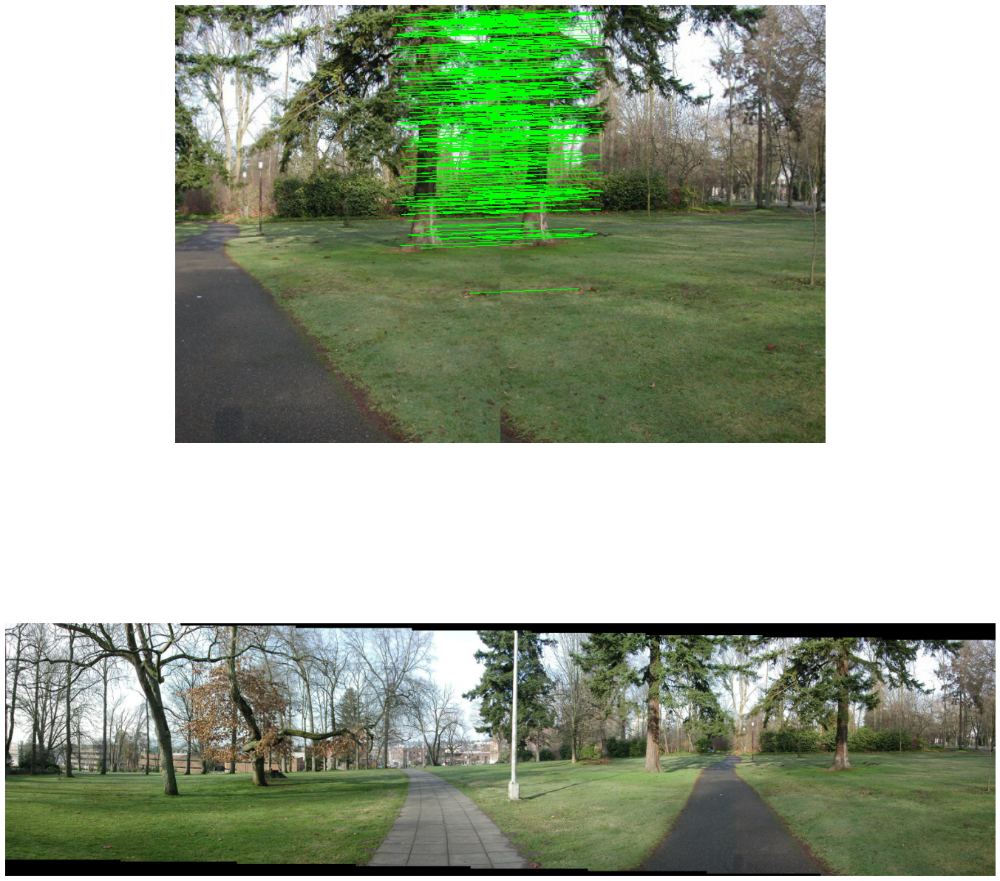

Process 8/17 images in directory:parrington
h: [[1.00000000e+00 0.00000000e+00 1.95503827e+03]
 [0.00000000e+00 1.00000000e+00 4.00000000e+01]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
0 535 0 2322


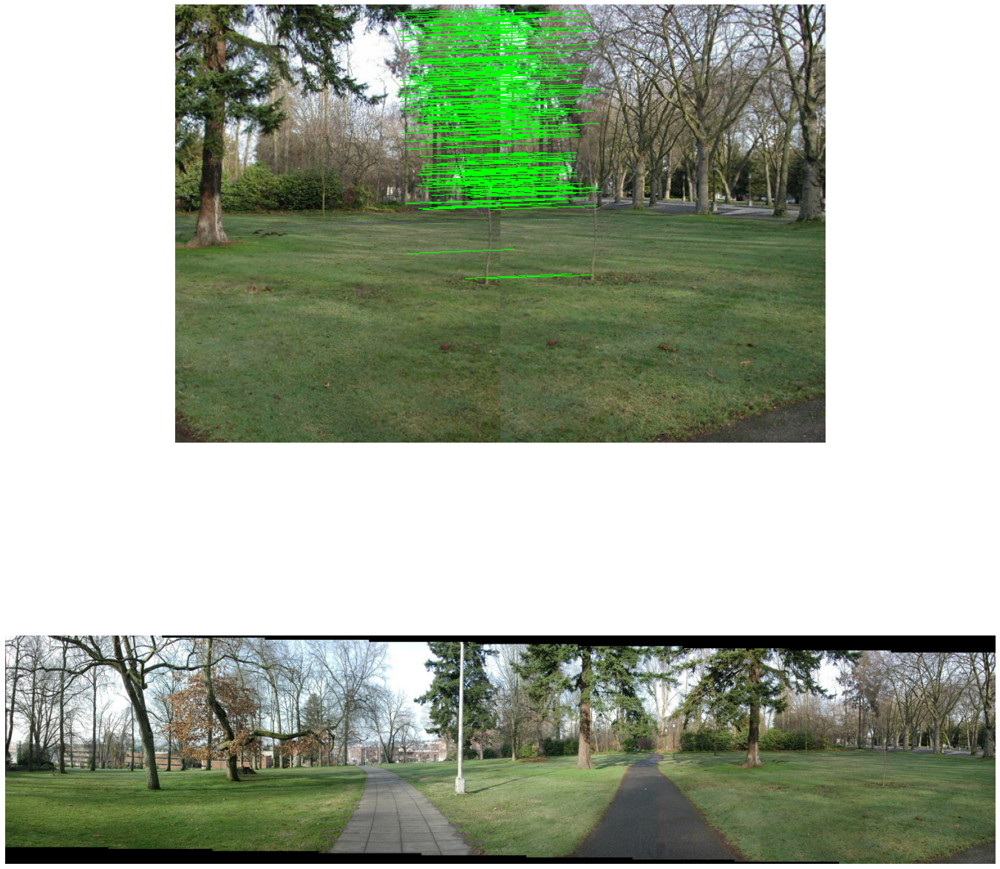

Process 9/17 images in directory:parrington
h: [[1.00000000e+00 0.00000000e+00 2.20155828e+03]
 [0.00000000e+00 1.00000000e+00 4.50000000e+01]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
0 540 0 2569


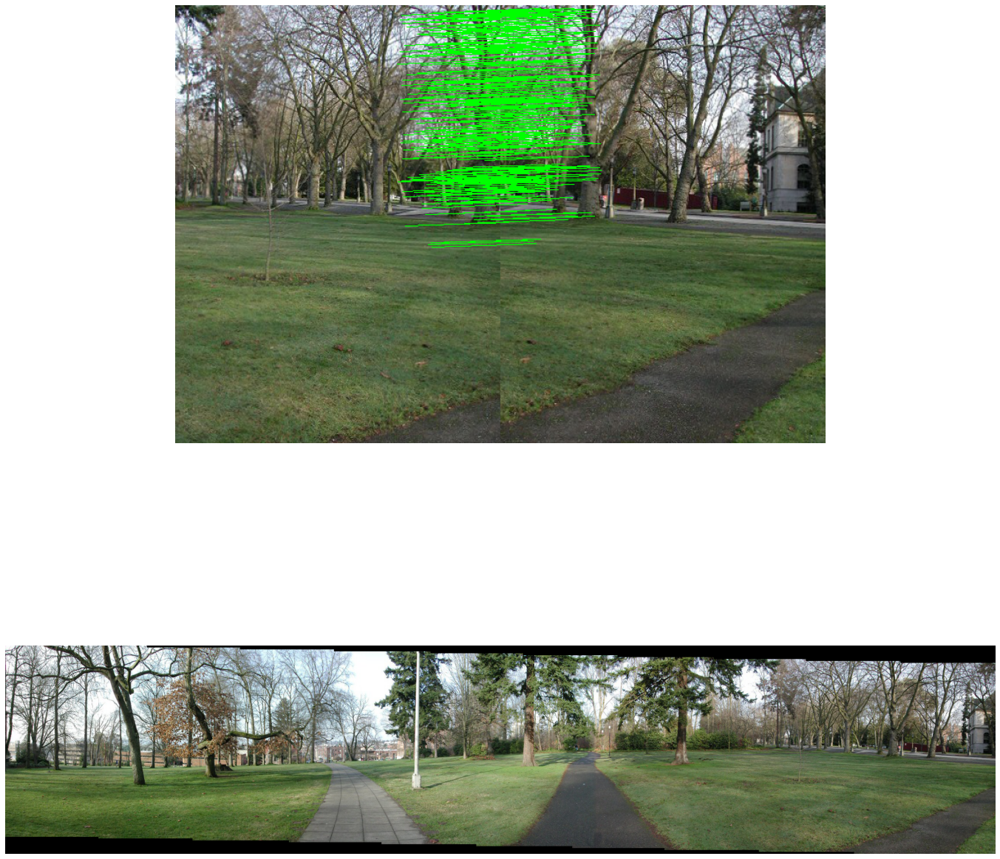

Process 10/17 images in directory:parrington
h: [[1.00000000e+00 0.00000000e+00 2.44263281e+03]
 [0.00000000e+00 1.00000000e+00 5.00000000e+01]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
0 545 0 2810


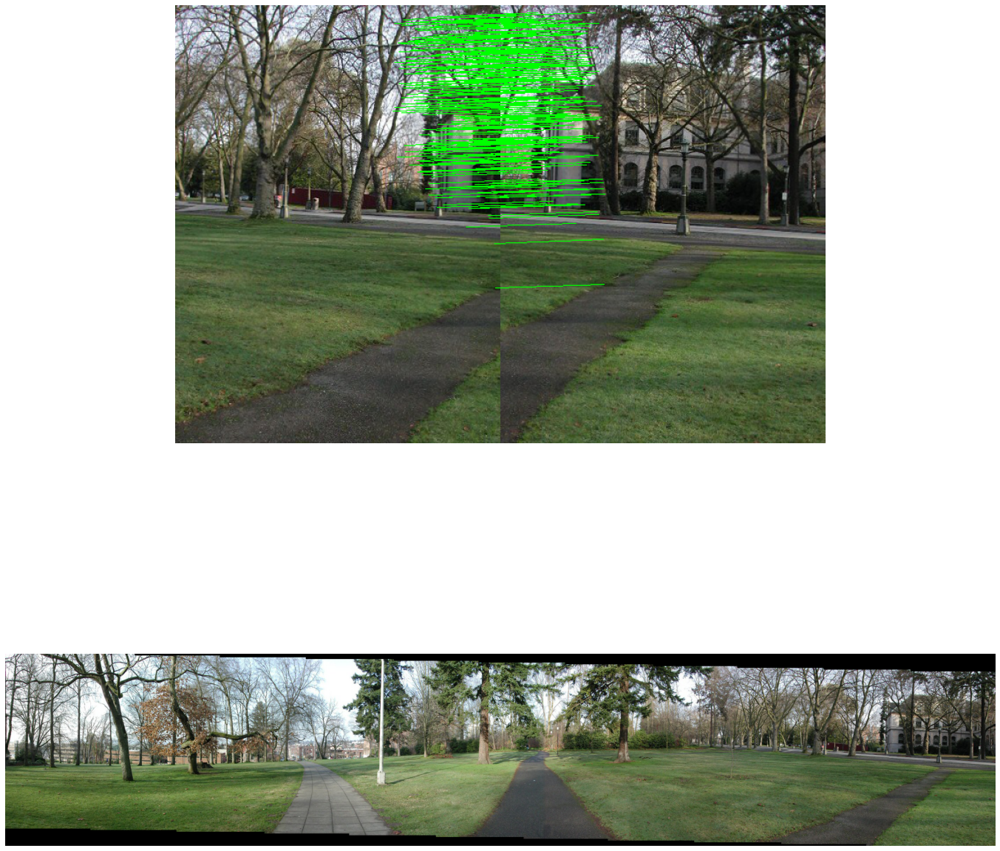

Process 11/17 images in directory:parrington
h: [[1.00000000e+00 0.00000000e+00 2.69324961e+03]
 [0.00000000e+00 1.00000000e+00 5.50000000e+01]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
0 550 0 3060


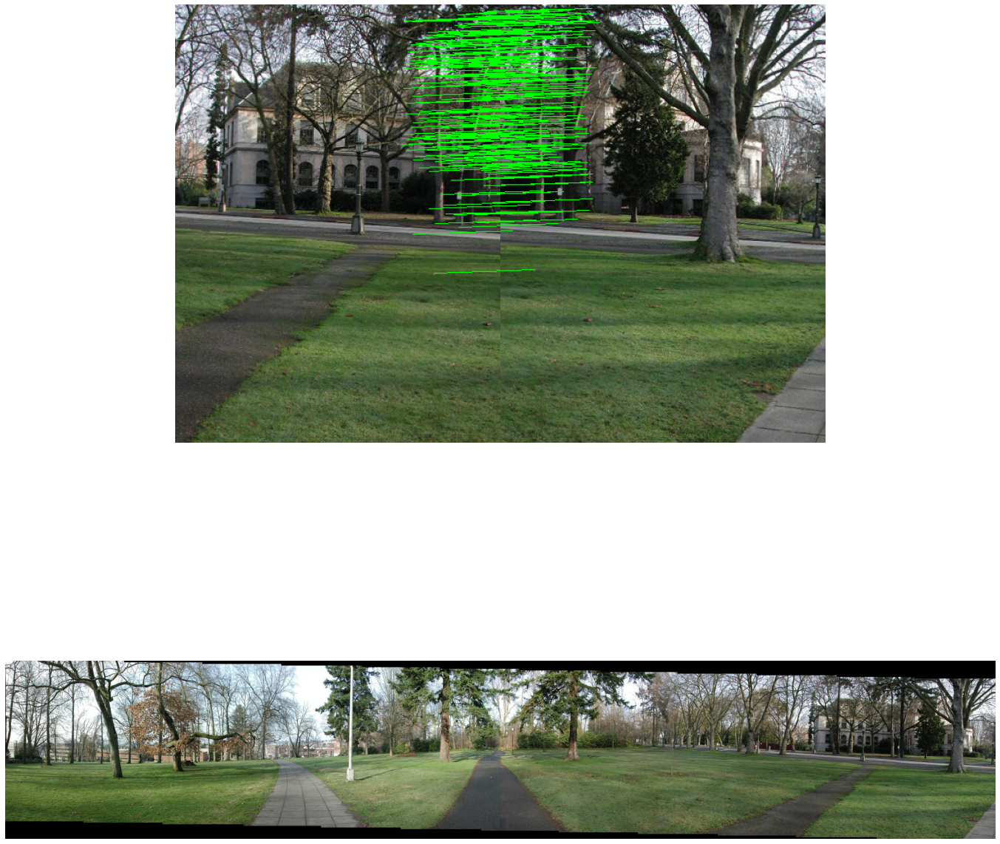

Process 12/17 images in directory:parrington
h: [[1.00000000e+00 0.00000000e+00 2.93504019e+03]
 [0.00000000e+00 1.00000000e+00 6.00000000e+01]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
0 555 0 3302


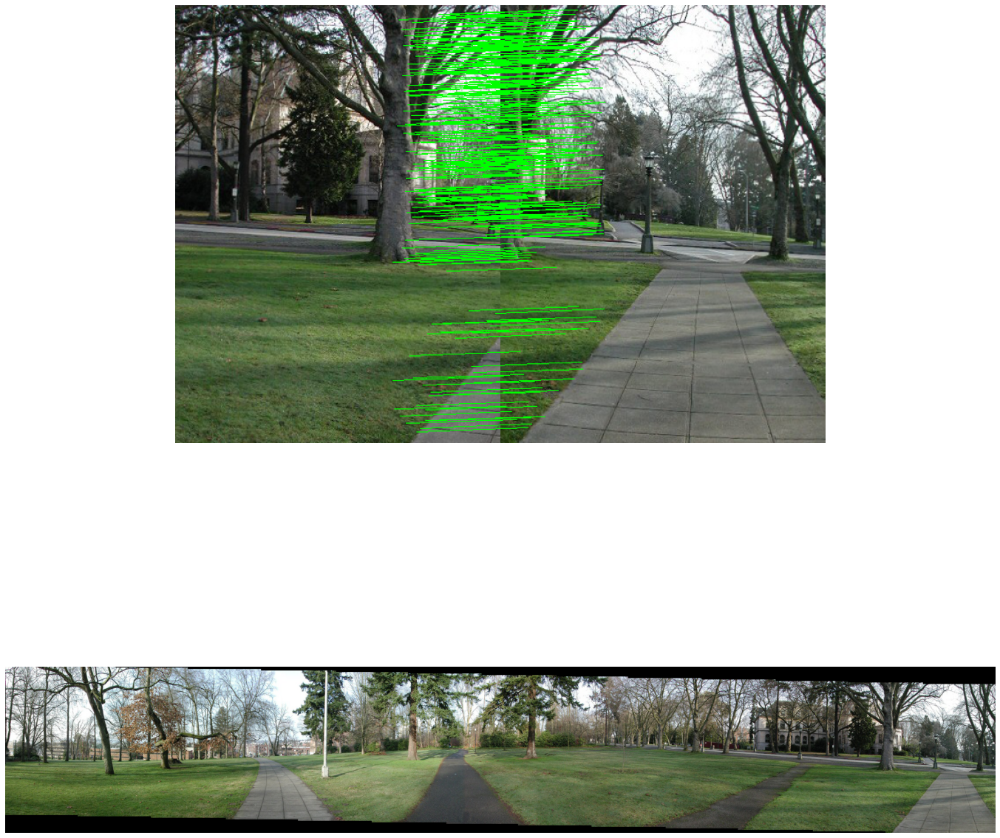

Process 13/17 images in directory:parrington
h: [[1.00000000e+00 0.00000000e+00 3.18463792e+03]
 [0.00000000e+00 1.00000000e+00 6.50000000e+01]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
0 560 0 3552


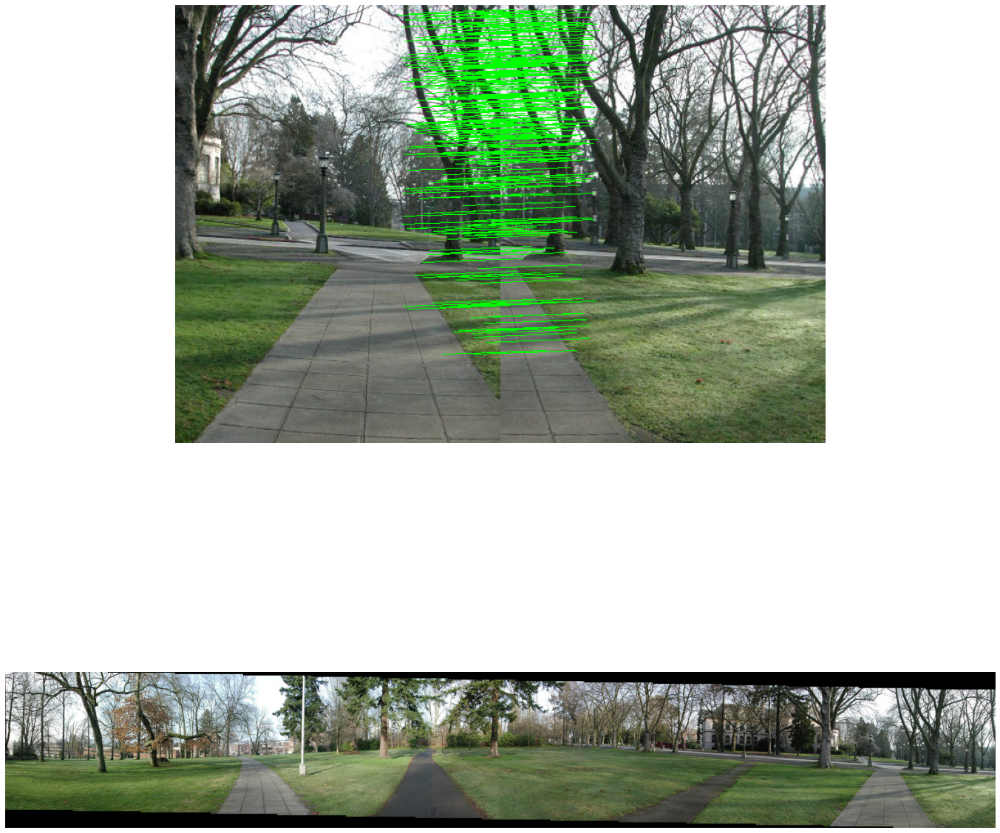

Process 14/17 images in directory:parrington
h: [[1.00000000e+00 0.00000000e+00 3.42531429e+03]
 [0.00000000e+00 1.00000000e+00 7.00000000e+01]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
0 565 0 3792


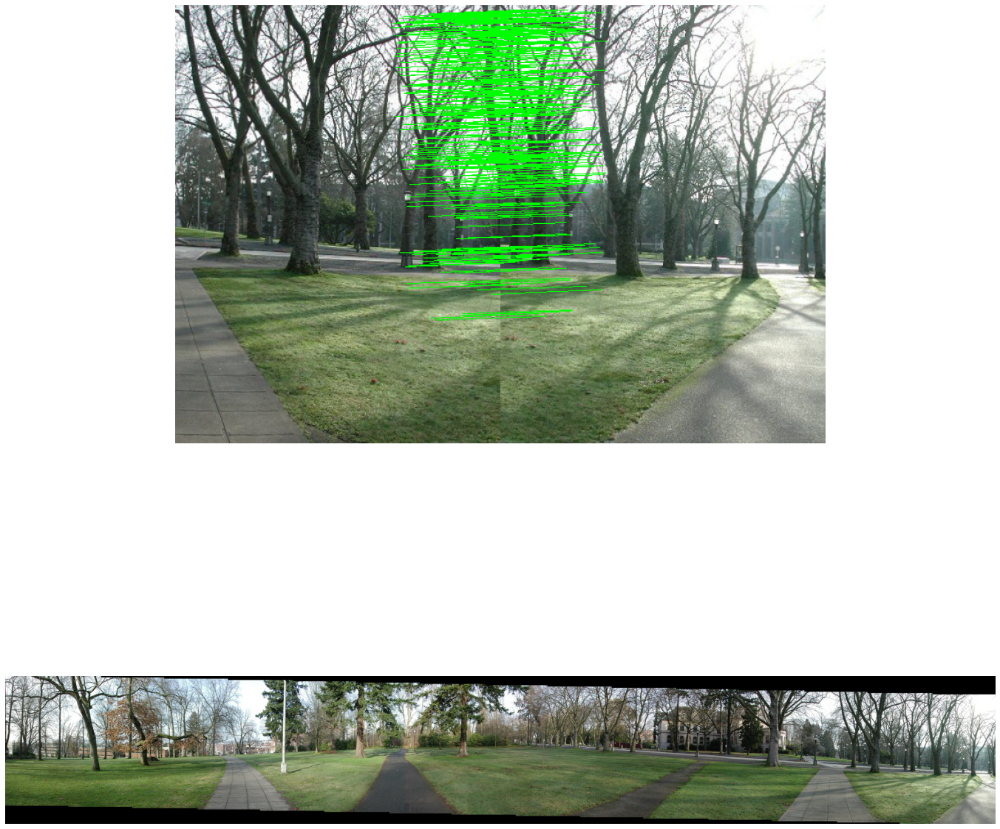

Process 15/17 images in directory:parrington
h: [[1.00000000e+00 0.00000000e+00 3.67039844e+03]
 [0.00000000e+00 1.00000000e+00 7.50000000e+01]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
0 570 0 4037


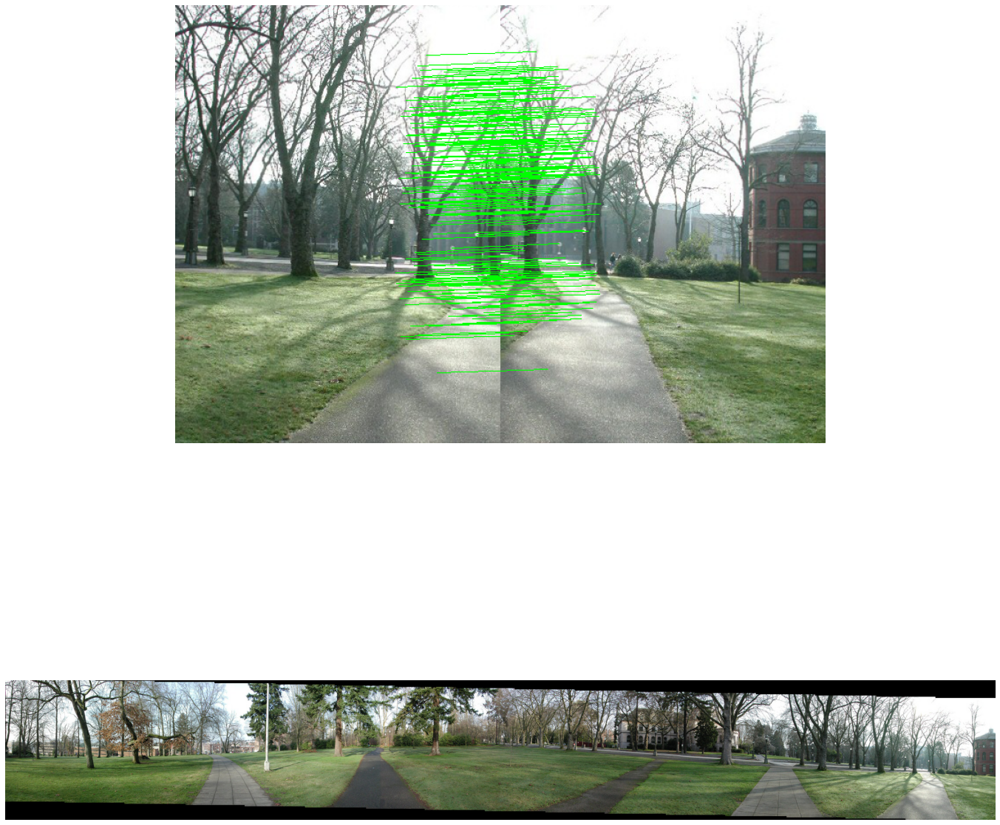

Process 16/17 images in directory:parrington
h: [[1.00000000e+00 0.00000000e+00 3.91666701e+03]
 [0.00000000e+00 1.00000000e+00 8.00000000e+01]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
0 575 0 4284


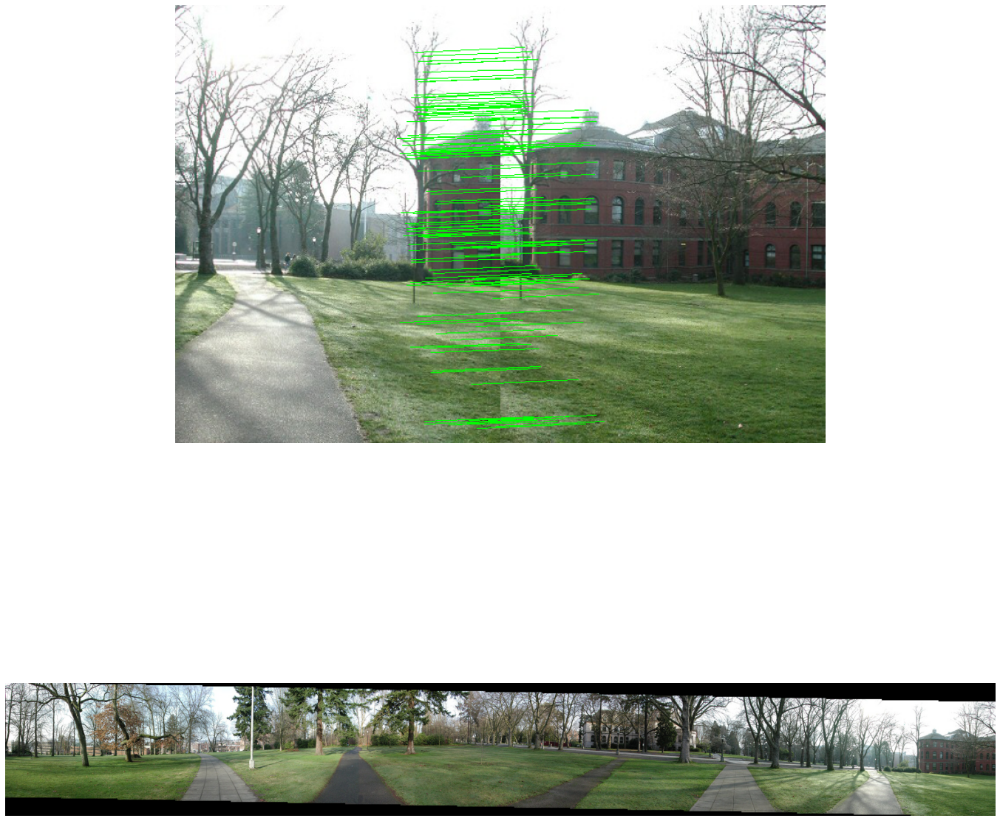

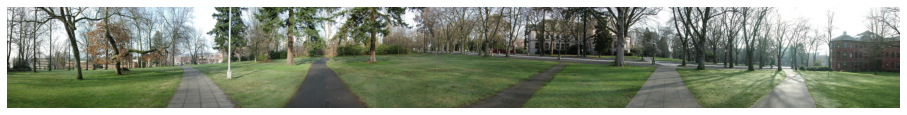

In [15]:
f = open('testfile.txt', 'r')
for line in f.readlines():
    dirname = str(line).strip()
    if dirname == "": continue
    print("target directory:", dirname)
    
    # Read images from directory
    images_list = read_directory(dirname)
    
    # Cylindrical projection, note estimated focal length = width + height
    init_image = cylindricalWarp(images_list[0], np.sum(images_list[0].shape[:2]))
    
    left_image_info = find_sift_descriptor(init_image)
    left_image_info['raw_img'] = init_image
    
    # Init merged image and its homographic matrix
    merged_image = init_image
    prev_h = np.identity(3)
    
    for idx, input_image in enumerate(images_list):
        if idx == 0: continue
        
        print("Process {}/{} images in directory:{}".format(idx, len(images_list), dirname))

        right_image = cylindricalWarp(input_image, np.sum(input_image.shape[:2]))
        right_image_info = find_sift_descriptor(right_image)
        right_image_info['raw_img'] = right_image

        matches_list, H, status = match(right_image_info, left_image_info)
        h = np.identity(3)

        # Offset trick
        MAX_HEIGHT_OFFSET = 5
        if dirname == "smangus": MAX_HEIGHT_OFFSET = 3

        height_offset = H[1, 2]
        if abs(height_offset) < MAX_HEIGHT_OFFSET:
            h[0:2, 2] = prev_h[0:2, 2] + H[0:2, 2]
        else:
            H[1, 2] = MAX_HEIGHT_OFFSET if (H[1, 2] > 0) else -MAX_HEIGHT_OFFSET
            h[0:2, 2] = prev_h[0:2, 2] + H[0:2, 2]
        print("h:", h)

        # Apply image pair warpping
        result_image = warp(merged_image, right_image_info['raw_img'], h, blending_mode="linearBlendingWithConstant", padding_height=20)
        a = result_image.astype(np.uint8)

        height_r, width_r = right_image_info['raw_img'].shape[:2]
        height_l, width_l = left_image_info['raw_img'].shape[:2]
        height_merged, width_merged = merged_image.shape[:2]
    
        ### Merge without linear blending start
        
        # a = cv2.warpPerspective(right_image_info['raw_img'],
        #                              h,
        #                              (width_merged + width_r, height_merged))
        # a[0:height_merged, 0:width_merged] = merged_image
        ### Merge without linear blending start

        # Crop image bound
        (upper_bound, bottom_bound, left_bound, right_bound) = get_image_bound(a)
        a = a[upper_bound:bottom_bound, left_bound:right_bound]

        # Visualization
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(24, 24))
        matching_vis_image = draw_matches(right_image_info, left_image_info , matches_list)
        ax1.imshow(cv2.cvtColor(matching_vis_image, cv2.COLOR_BGR2RGB))
        ax1.axis('off')

        ax2.imshow(cv2.cvtColor(a, cv2.COLOR_BGR2RGB))
        ax2.axis('off')
        plt.show()

        # Update variables
        merged_image = a
        left_image_info = right_image_info
        prev_h = h

    # Post-processing
    aligned_image = end2end_align(merged_image, (prev_h[1, 2], prev_h[0, 2]))
    cropped_image = crop(aligned_image)
    cv2.imwrite(dirname + ".jpg", cropped_image)

    plt.figure(figsize=(16, 9))
    plt.imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()
